# Import libraries

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv) 
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import sys, gc, os, random, glob, cv2, math
import albumentations as albu # import data augmentation

from tqdm import tqdm
from glob import glob
from mrcnn import utils
from mrcnn import visualize
from mrcnn.config import Config
from PIL import Image
from bokeh.plotting import figure
from bokeh.io import output_notebook, show, output_file
from bokeh.models import ColumnDataSource, HoverTool, Panel
from albumentations import Compose, RandomSizedBBoxSafeCrop, HorizontalFlip, VerticalFlip, OneOf, CLAHE, BboxParams
from albumentations.augmentations.transforms import RandomGamma, RandomBrightnessContrast
# from bokeh.models.widgets import Tabs
# from mrcnn.model import log
# import mrcnn.model as modellib

/Users/byron/Documents/GitHub/ODLG4/.venv/lib/python3.10/site-packages/albumentations/check_version.py:49: UserWarning: Error fetching version info <urlopen error [SSL: CERTIFICATE_VERIFY_FAILED] certificate verify failed: unable to get local issuer certificate (_ssl.c:997)>
  data = fetch_version_info()


# Configurations

In [2]:
# for reproducibility
def seed_all(SEED):
    random.seed(SEED)
    np.random.seed(SEED)
    os.environ['PYTHONHASHSEED'] = str(SEED)

seed_all(42)
# sns.set(style="darkgrid")
# %matplotlib inline

In [3]:
# Mask RCNN Model Configuration
class WheatDetectorConfig(Config):
    # Give the configuration a recognizable name  
    NAME = 'wheat'
    
    # set the number of GPUs to use along with the number of images
    # per GPU
    GPU_COUNT = 1
    IMAGES_PER_GPU = 2
    BACKBONE = 'resnet101'
    
    # number of classes (we would normally add +1 for the background)
    # BG + Wheat
    NUM_CLASSES = 2
    
    IMAGE_RESIZE_MODE = "square"
    IMAGE_MIN_DIM = 1024
    IMAGE_MAX_DIM = 1024
    
    # Number of training steps per epoch
    STEPS_PER_EPOCH = 120
    
    # Use different size anchors because our target objects are multi-scale (wheats are some too big, some too small)
    RPN_ANCHOR_SCALES = (16, 32, 64, 128, 256)  # anchor side in pixels
    BACKBONE_STRIDES = [4, 8, 16, 32, 64]
    
    # Learning rate
    LEARNING_RATE = 0.005
    WEIGHT_DECAY  = 0.0005
    
    # Maximum number of ROI’s, the Region Proposal Network (RPN) will generate for the image
    TRAIN_ROIS_PER_IMAGE = 350 
    
    # Skip detections with < 60% confidence
    DETECTION_MIN_CONFIDENCE = 0.60
    
    # Increase with larger training
    VALIDATION_STEPS = 60
    
    # Maximum number of instances that can be detected in one image.
    MAX_GT_INSTANCES = 500 # 200 
 
    # Loss weights for more precise optimization.
    # Can be used for R-CNN training setup.
    LOSS_WEIGHTS = {
        "rpn_class_loss": 1.0,
        "rpn_bbox_loss": 1.0,
        "mrcnn_class_loss": 1.0,
        "mrcnn_bbox_loss": 1.0,
        "mrcnn_mask_loss": 1.0
        }

# Setup the paths to train and test images
TRAIN_DIR = './global-wheat-detection/train/'
TEST_DIR = './global-wheat-detection/test/'
TRAIN_CSV_PATH = './global-wheat-detection/train.csv'
AUG_SAVE_DIR = './global-wheat-detection/augmented_images/'

if not os.path.exists(AUG_SAVE_DIR):
    os.makedirs(AUG_SAVE_DIR)

config = WheatDetectorConfig()
config.display()


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     2
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.6
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 2
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                14
IMAGE_MIN_DIM                  1024
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.005
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE                     [28, 28]
MAX_GT_INST

In [4]:
w_arr = []
h_arr = []

for i in tqdm(os.listdir(TRAIN_DIR), desc='Calculating Average Width and Height'):
    image = cv2.imread(os.path.join(TRAIN_DIR, i))
    image_size = image.shape[:2]
    w_arr.append(image_size[0])
    h_arr.append(image_size[1])

print('Average Width:', np.mean(w_arr))
print('Average Height:', np.mean(h_arr))

ORIG_SIZE     = np.mean(w_arr)
epoch         = 100

Calculating Average Width and Height: 100%|██████████| 3422/3422 [00:34<00:00, 100.05it/s]

Average Width: 1024.0
Average Height: 1024.0


# Data Loading

In [5]:
# Glob the directories and get the lists of train and test images
train_fns = glob(TRAIN_DIR + '*')
test_fns = glob(TEST_DIR + '*')
print('Number of train images is {}'.format(len(train_fns)))
print('Number of test images is {}'.format(len(test_fns)))

Number of train images is 3422
Number of test images is 10


In [6]:
# load annotation files
df = pd.read_csv('./global-wheat-detection/train.csv')
df.head()

,image_id,width,height,bbox,source
0,b6ab77fd7,1024,1024,"[834.0, 222.0, 56.0, 36.0]",usask_1
1,b6ab77fd7,1024,1024,"[226.0, 548.0, 130.0, 58.0]",usask_1
2,b6ab77fd7,1024,1024,"[377.0, 504.0, 74.0, 160.0]",usask_1
3,b6ab77fd7,1024,1024,"[834.0, 95.0, 109.0, 107.0]",usask_1
4,b6ab77fd7,1024,1024,"[26.0, 144.0, 124.0, 117.0]",usask_1


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 147793 entries, 0 to 147792
Data columns (total 5 columns):
 #   Column    Non-Null Count   Dtype 
---  ------    --------------   ----- 
 0   image_id  147793 non-null  object
 1   width     147793 non-null  int64 
 2   height    147793 non-null  int64 
 3   bbox      147793 non-null  object
 4   source    147793 non-null  object
dtypes: int64(2), object(3)
memory usage: 5.6+ MB


In [8]:
# image without wheat
len(os.listdir('./global-wheat-detection/train/')) - len(df.image_id.unique())

49

In [9]:
# bearing of box to x, y, w, h
df['bbox'] = df['bbox'].apply(lambda x: x[1:-1].split(","))

df['x'] = df['bbox'].apply(lambda x: x[0]).astype('float32')
df['y'] = df['bbox'].apply(lambda x: x[1]).astype('float32')
df['w'] = df['bbox'].apply(lambda x: x[2]).astype('float32')
df['h'] = df['bbox'].apply(lambda x: x[3]).astype('float32')

df = df[['image_id','x', 'y', 'w', 'h', 'source']]
df.head()

,image_id,x,y,w,h,source
0,b6ab77fd7,834.0,222.0,56.0,36.0,usask_1
1,b6ab77fd7,226.0,548.0,130.0,58.0,usask_1
2,b6ab77fd7,377.0,504.0,74.0,160.0,usask_1
3,b6ab77fd7,834.0,95.0,109.0,107.0,usask_1
4,b6ab77fd7,26.0,144.0,124.0,117.0,usask_1


In [10]:
# Create a dataframe with all train images
df_full = pd.DataFrame([fns.split('/')[-1][:-4] for fns in train_fns])
df_full.columns=['image_id']

# Merge all train images with the bounding boxes dataframe
df_full = df_full.merge(df, on='image_id', how='left')

# replace nan values with zeros
df_full['x'] = df_full.x.fillna(0)
df_full['y'] = df_full.y.fillna(0)
df_full['w'] = df_full.w.fillna(0)
df_full['h'] = df_full.h.fillna(0)
df_full['source'] = df_full.source.fillna('no_wheat')

In [11]:
df_full.head()

,image_id,x,y,w,h,source
0,75d62c43e,863.0,741.0,132.0,67.0,arvalis_3
1,75d62c43e,844.0,980.0,133.0,44.0,arvalis_3
2,75d62c43e,736.0,798.0,68.0,63.0,arvalis_3
3,75d62c43e,825.0,630.0,137.0,68.0,arvalis_3
4,75d62c43e,853.0,223.0,152.0,142.0,arvalis_3


In [12]:
df_full.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 147842 entries, 0 to 147841
Data columns (total 6 columns):
 #   Column    Non-Null Count   Dtype  
---  ------    --------------   -----  
 0   image_id  147842 non-null  object 
 1   x         147842 non-null  float32
 2   y         147842 non-null  float32
 3   w         147842 non-null  float32
 4   h         147842 non-null  float32
 5   source    147842 non-null  object 
dtypes: float32(4), object(2)
memory usage: 4.5+ MB


In [13]:
df_full.to_csv('df_full.csv', index=False)
df_full = pd.read_csv('df_full.csv')
df_full.head(10)

,image_id,x,y,w,h,source
0,75d62c43e,863.0,741.0,132.0,67.0,arvalis_3
1,75d62c43e,844.0,980.0,133.0,44.0,arvalis_3
2,75d62c43e,736.0,798.0,68.0,63.0,arvalis_3
3,75d62c43e,825.0,630.0,137.0,68.0,arvalis_3
4,75d62c43e,853.0,223.0,152.0,142.0,arvalis_3
5,75d62c43e,916.0,882.0,108.0,101.0,arvalis_3
6,75d62c43e,796.0,870.0,76.0,69.0,arvalis_3
7,75d62c43e,885.0,386.0,80.0,89.0,arvalis_3
8,75d62c43e,712.0,495.0,114.0,57.0,arvalis_3
9,75d62c43e,800.0,380.0,104.0,74.0,arvalis_3


# EDA

In [14]:
df_eda = df_full.copy()

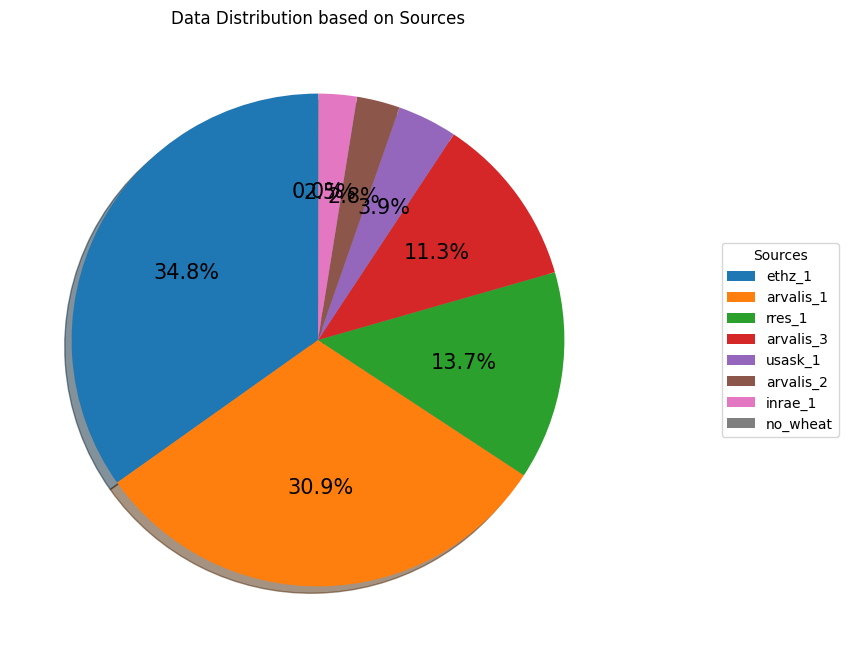

In [15]:
counts = dict(df_eda['source'].value_counts())

fig, ax = plt.subplots(figsize=(8,8));
wedges, texts, autotexts = ax.pie(list(counts.values()), autopct='%1.1f%%',
        shadow=True, startangle=90);
ax.legend(wedges, list(counts.keys()),
          title="Sources",
          loc="center",
          bbox_to_anchor=(1, 0, 0.5, 1));

plt.setp(autotexts, size=15);

ax.set_title("Data Distribution based on Sources");
plt.show();

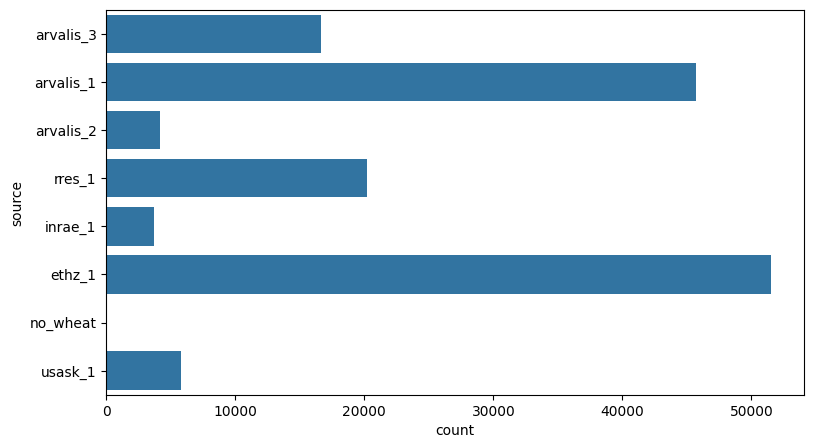

In [16]:
# source distribution
plt.figure(figsize=(9,5))
sns.countplot(df_eda.source)
plt.show()

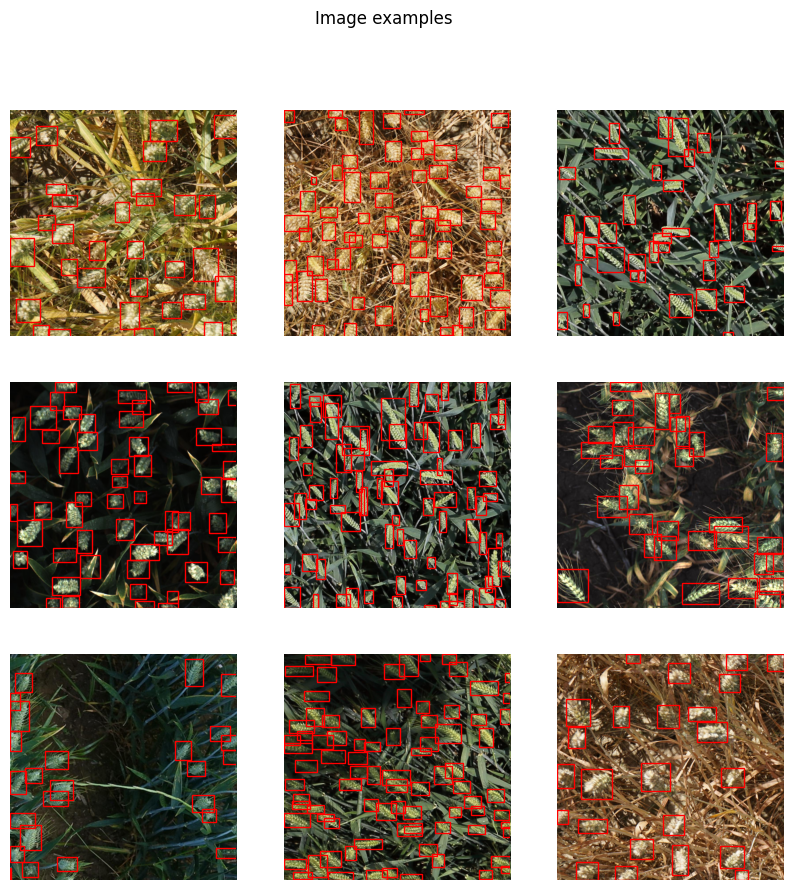

In [17]:
def get_all_bboxes(df, image_id):
    image_bboxes = df[df.image_id == image_id]
    
    bboxes = []
    for _,row in image_bboxes.iterrows():
        bboxes.append((row.x, row.y, row.w, row.h))
        
    return bboxes

def plot_image_examples(df, rows=3, cols=3, title='Image examples'):
    fig, axs = plt.subplots(rows, cols, figsize=(10,10))
    for row in range(rows):
        for col in range(cols):
            idx = np.random.randint(len(df), size=1)[0]
            img_id = df.iloc[idx].image_id
            
            img = Image.open(TRAIN_DIR + img_id + '.jpg')
            axs[row, col].imshow(img)
            
            bboxes = get_all_bboxes(df, img_id)
            
            for bbox in bboxes:
                rect = patches.Rectangle((bbox[0],bbox[1]),bbox[2],bbox[3],linewidth=1,edgecolor='r',facecolor='none')
                axs[row, col].add_patch(rect)
            
            axs[row, col].axis('off')
            
    plt.suptitle(title)

plot_image_examples(df_full)

In [18]:
# compute the number of bounding boxes per train image
df_eda['count'] = df_eda.apply(lambda row: 1 if np.isfinite(row.w) else 0, axis=1)
df_eda_count = df_eda.groupby('image_id').sum().reset_index()

In [19]:
def hist_hover(dataframe, column, colors=["#94c8d8", "#ea5e51"], bins=30, title=''):
    hist, edges = np.histogram(dataframe[column], bins = bins)
    
    hist_df = pd.DataFrame({column: hist,
                             "left": edges[:-1],
                             "right": edges[1:]})
    hist_df["interval"] = ["%d to %d" % (left, right) for left, 
                           right in zip(hist_df["left"], hist_df["right"])]

    src = ColumnDataSource(hist_df)
    plot = figure(height = 400, width = 600,
          title = title,
          x_axis_label = column,
          y_axis_label = "Count")    
    plot.quad(bottom = 0, top = column,left = "left", 
        right = "right", source = src, fill_color = colors[0], 
        line_color = "#35838d", fill_alpha = 0.7,
        hover_fill_alpha = 0.7, hover_fill_color = colors[1])
        
    hover = HoverTool(tooltips = [('Interval', '@interval'),
                              ('Count', str("@" + column))])
    plot.add_tools(hover)
    
    output_notebook()
    show(plot)

hist_hover(df_eda_count, 'count', title='Number of wheat spikes per image')

Loading BokehJS ...

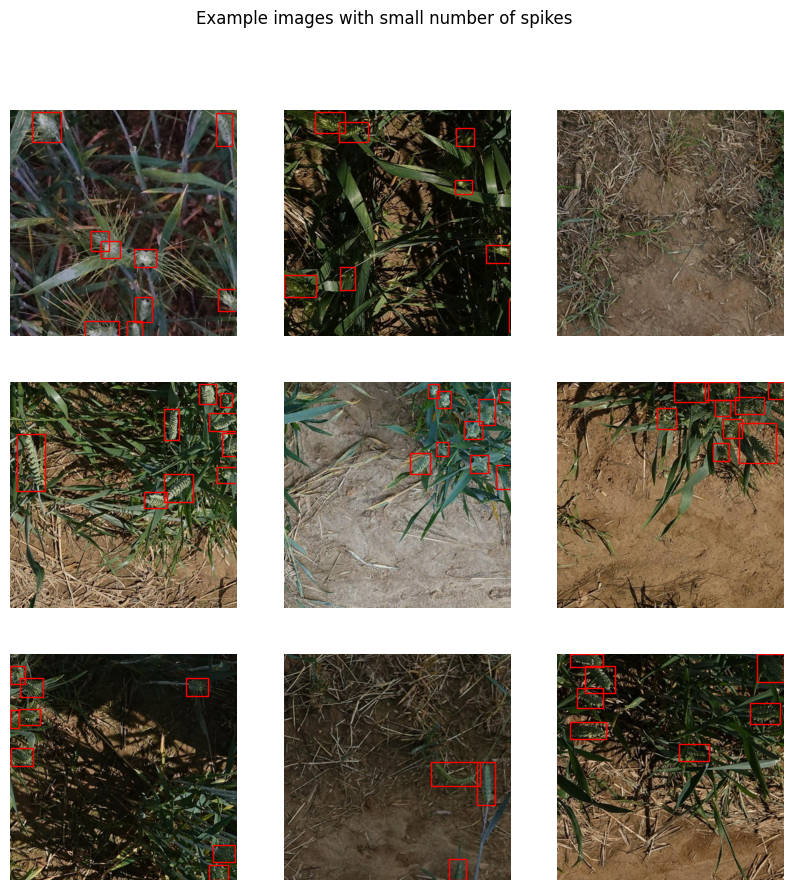

In [20]:
less_spikes_ids = df_eda_count[df_eda_count['count'] < 10].image_id
plot_image_examples(df_eda[df_eda.image_id.isin(less_spikes_ids)], title='Example images with small number of spikes')

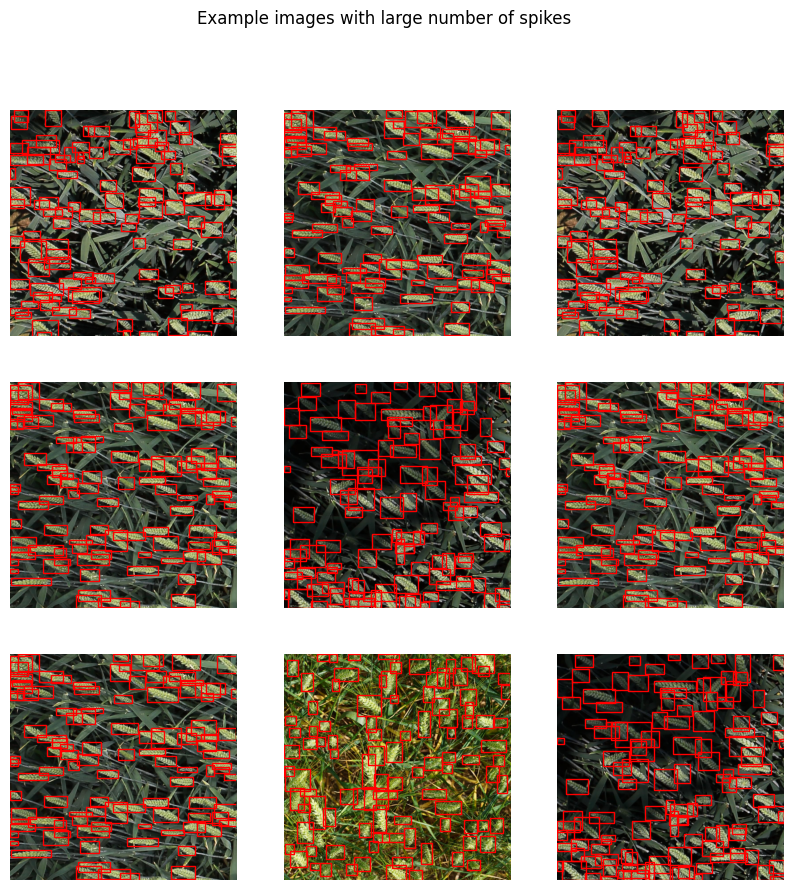

In [21]:
many_spikes_ids = df_eda_count[df_eda_count['count'] > 100].image_id
plot_image_examples(df_eda[df_eda.image_id.isin(many_spikes_ids)], title='Example images with large number of spikes')

In [22]:
# compute bounding box areas
df_eda['area'] =df_eda['w'] * df_eda['h']

In [23]:
# plot a histogram of bounding box areas
hist_hover(df_eda, 'area', title='Area of a single bounding box')

Loading BokehJS ...

In [24]:
df_eda.area.max()

529788.0

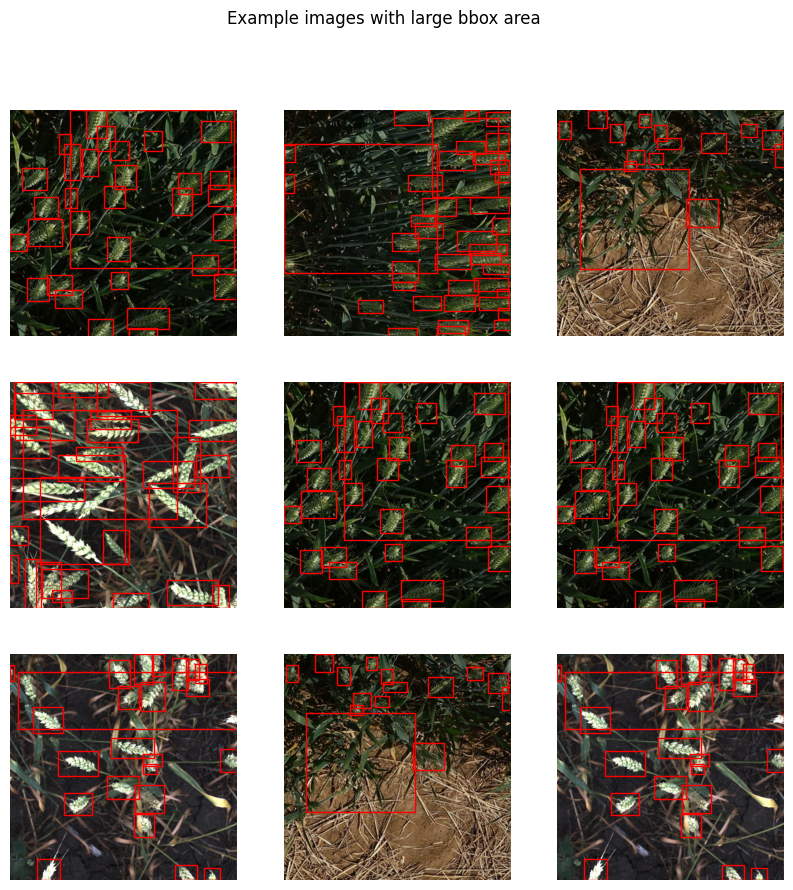

In [25]:
large_boxes_ids = df_eda[df_eda['area'] > 200000].image_id
plot_image_examples(df_eda[df_eda.image_id.isin(large_boxes_ids)], title='Example images with large bbox area')

In [26]:
min_area = df_eda[df_eda['area'] > 0].area.min()
print('The smallest bounding box area is {}'.format(min_area))

The smallest bounding box area is 2.0


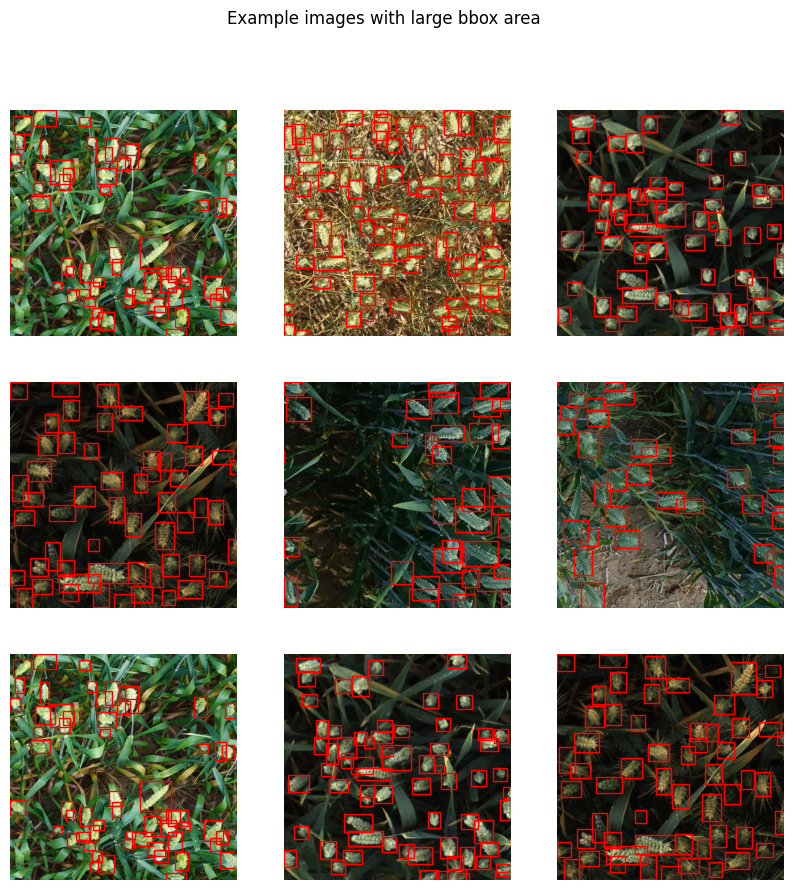

In [27]:
small_boxes_ids = df_eda[(df_eda['area'] < 50) & (df_eda['area'] > 0)].image_id
plot_image_examples(df_eda[df_eda.image_id.isin(small_boxes_ids)], title='Example images with large bbox area')

In [28]:
# compute the total bounding boxes area per image
area_per_image = df_eda.groupby(by='image_id').sum().reset_index()

# compute the percentage of the image area covered by bounding boxes
area_per_image_percentage = area_per_image.copy()
area_per_image_percentage['area'] = area_per_image_percentage['area'] / (1024*1024) * 100

In [29]:
hist_hover(area_per_image_percentage, 'area', title='Percentage of image area covered by bounding boxes')

Loading BokehJS ...

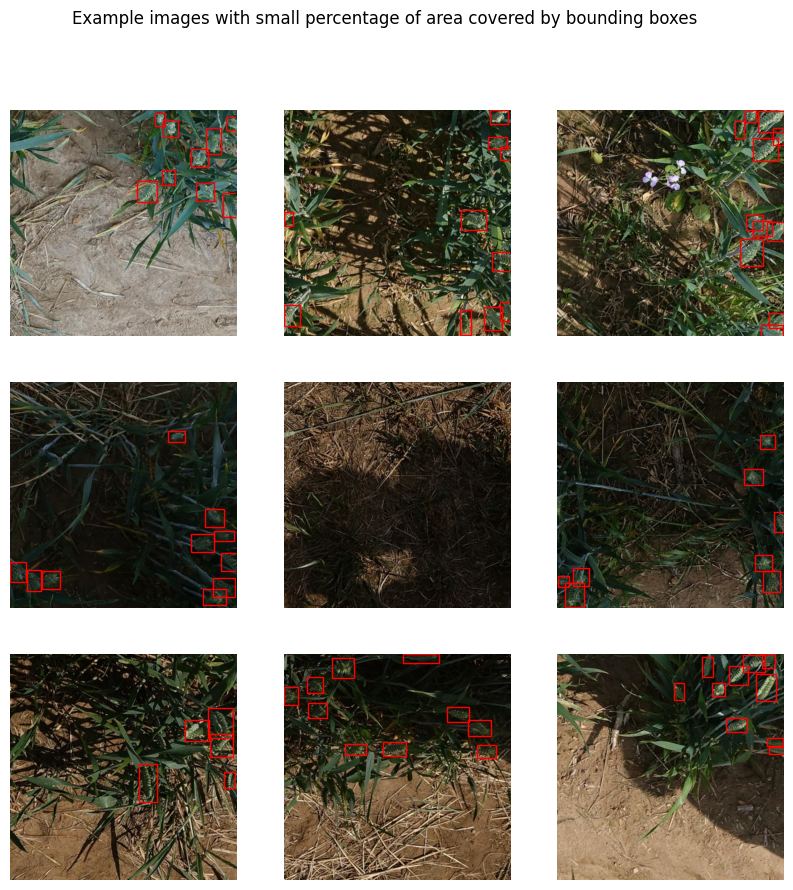

In [30]:
small_area_perc_ids = area_per_image_percentage[area_per_image_percentage['area'] < 7].image_id
plot_image_examples(df_eda[df_eda.image_id.isin(small_area_perc_ids)], title='Example images with small percentage of area covered by bounding boxes')

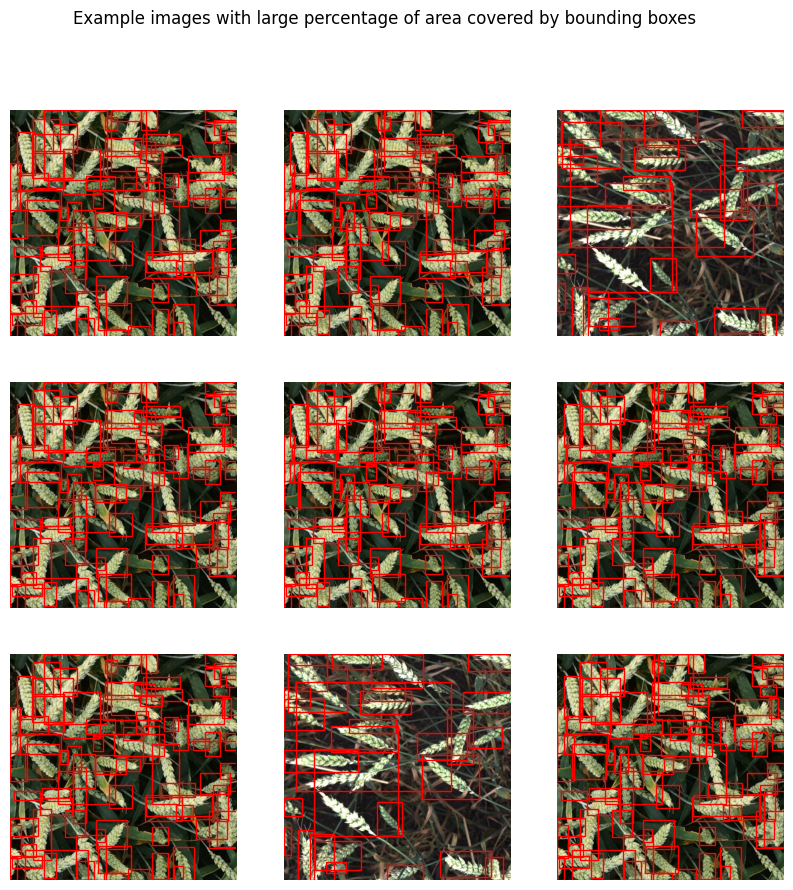

In [31]:
large_area_perc_ids = area_per_image_percentage[area_per_image_percentage['area'] > 95].image_id
plot_image_examples(df_eda[df_eda.image_id.isin(large_area_perc_ids)], title='Example images with large percentage of area covered by bounding boxes')

In [32]:
def get_image_brightness(image):
    # convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # get average brightness
    return np.array(gray).mean()

def add_brightness(df):
    brightness = []
    for _, row in df.iterrows():
        img_id = row.image_id  
        image = cv2.imread(TRAIN_DIR + img_id + '.jpg')
        brightness.append(get_image_brightness(image))
        
    brightness_df = pd.DataFrame(brightness)
    brightness_df.columns = ['brightness']
    df = pd.concat([df, brightness_df], ignore_index=True, axis=1)
    df.columns = ['image_id', 'brightness']
    
    return df

In [33]:
images_df = pd.DataFrame(df_eda.image_id.unique())
images_df.columns = ['image_id']

In [34]:
# add brightness to the dataframe
images_df = pd.DataFrame(df_eda.image_id.unique())
images_df.columns = ['image_id']
brightness_df = add_brightness(images_df)

df_eda = df_eda.merge(brightness_df, on='image_id')

In [35]:
hist_hover(df_eda, 'brightness', title='Images brightness distribution')

Loading BokehJS ...

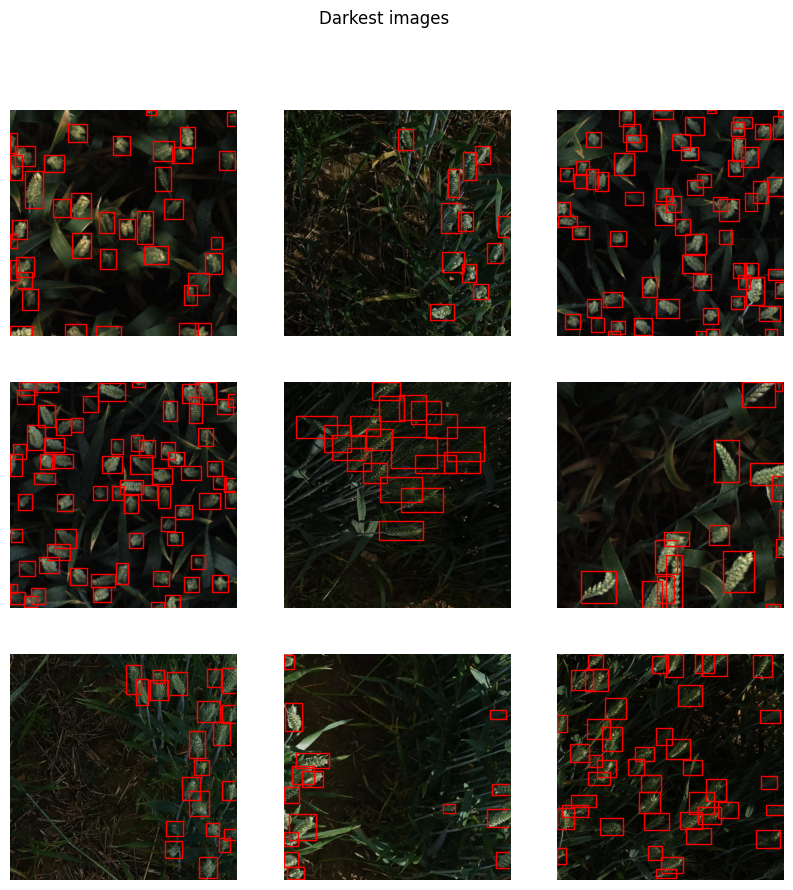

In [36]:
dark_ids = df_eda[df_eda['brightness'] < 30].image_id
plot_image_examples(df_eda[df_eda.image_id.isin(dark_ids)], title='Darkest images')

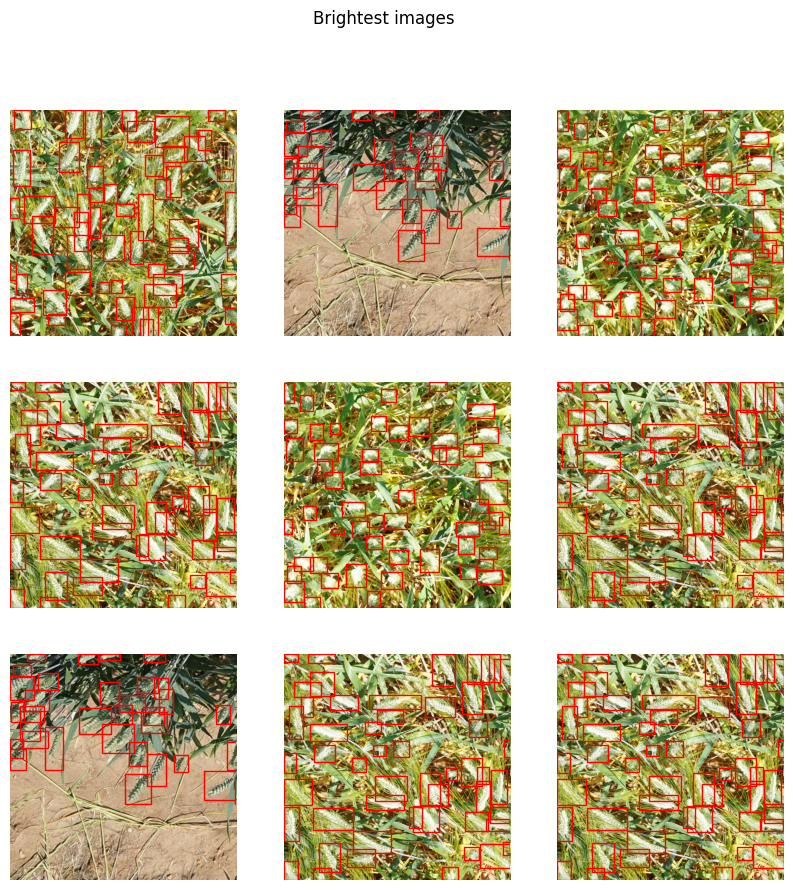

In [37]:
bright_ids = df_eda[df_eda['brightness'] > 130].image_id
plot_image_examples(df_eda[df_eda.image_id.isin(bright_ids)], title='Brightest images')

In [38]:
def get_percentage_of_green_pixels(image):
    # convert to HSV
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    
    # get the green mask
    hsv_lower = (40, 40, 40) 
    hsv_higher = (70, 255, 255)
    green_mask = cv2.inRange(hsv, hsv_lower, hsv_higher)
    
    return float(np.sum(green_mask)) / 255 / (1024 * 1024)

def get_percentage_of_yellow_pixels(image):
    # convert to HSV
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    
    # get the yellow mask
    hsv_lower = (25, 40, 40) 
    hsv_higher = (35, 255, 255)
    yellow_mask = cv2.inRange(hsv, hsv_lower, hsv_higher)
    
    return float(np.sum(yellow_mask)) / 255 / (1024 * 1024)

def add_green_pixels_percentage(df):
    green = []
    for _, row in df.iterrows():
        img_id = row.image_id  
        image = cv2.imread(TRAIN_DIR + img_id + '.jpg')
        green.append(get_percentage_of_green_pixels(image))
        
    green_df = pd.DataFrame(green)
    green_df.columns = ['green_pixels']
    df = pd.concat([df, green_df], ignore_index=True, axis=1)
    df.columns = ['image_id', 'green_pixels']
    
    return df

def add_yellow_pixels_percentage(df):
    yellow = []
    for _, row in df.iterrows():
        img_id = row.image_id  
        image = cv2.imread(TRAIN_DIR + img_id + '.jpg')
        yellow.append(get_percentage_of_yellow_pixels(image))
        
    yellow_df = pd.DataFrame(yellow)
    yellow_df.columns = ['yellow_pixels']
    df = pd.concat([df, yellow_df], ignore_index=True, axis=1)
    df.columns = ['image_id', 'yellow_pixels']
    
    return df

# add a column with the percentage of green pixels
green_pixels_df = add_green_pixels_percentage(images_df)
df_eda = df_eda.merge(green_pixels_df, on='image_id')

In [39]:
hist_hover(df_eda, 'green_pixels', title='Percentage of green pixels distribution', colors=['#c3ea84', '#3e7a17'])

Loading BokehJS ...

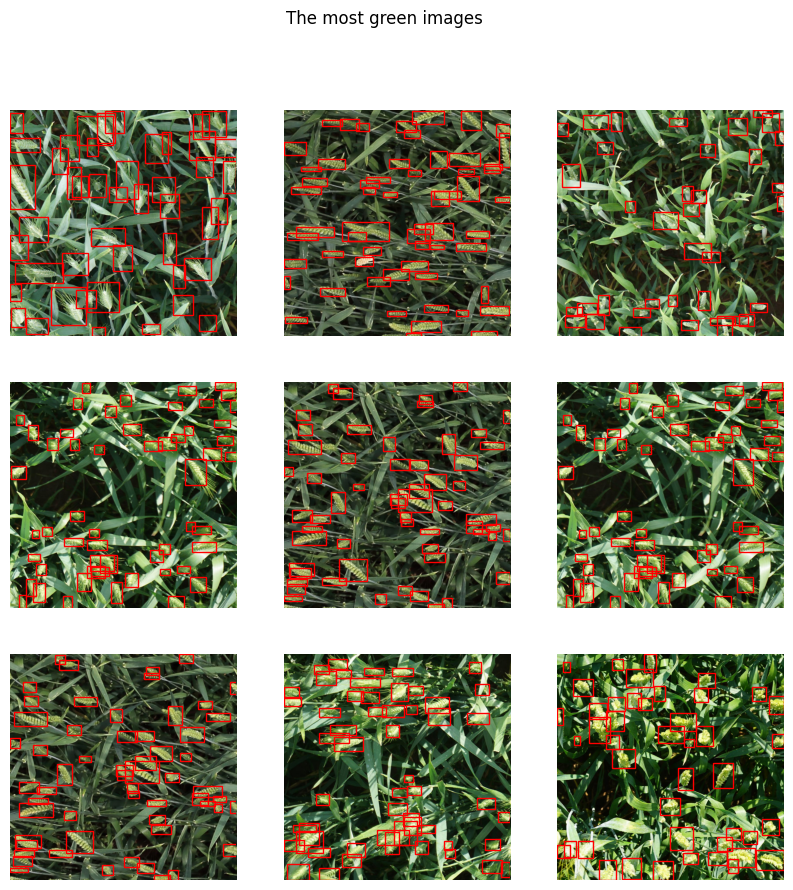

In [40]:
green_ids = df_eda[df_eda['green_pixels'] > 0.55].image_id
plot_image_examples(df_eda[df_eda.image_id.isin(green_ids)], title='The most green images')

In [41]:
# add a column with the percentage of yellow pixels
yellow_pixels_df = add_yellow_pixels_percentage(images_df)
df_eda = df_eda.merge(yellow_pixels_df, on='image_id')

In [42]:
hist_hover(df_eda, 'yellow_pixels', title='Percentage of yellow pixels distribution', colors=['#fffedb', '#fffeab'])

Loading BokehJS ...

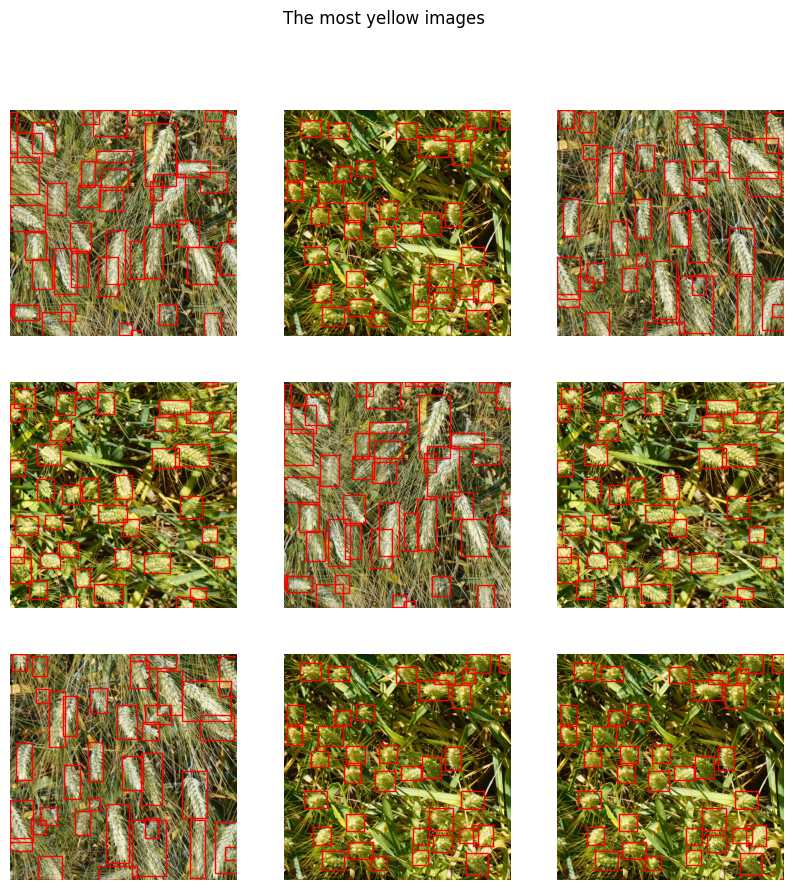

In [43]:
yellow_ids = df_eda[df_eda['yellow_pixels'] > 0.55].image_id
plot_image_examples(df_eda[df_eda.image_id.isin(yellow_ids)], title='The most yellow images')

# Data Generator

In [44]:
def get_jpg(img_dir, anns):
    id      = []
    jpg_fps = []

    for index, row in anns.iterrows():
        id.append(row['image_id'])

    for i in os.listdir(img_dir):
        if os.path.splitext(i)[0] not in id:
            continue
        else:
            jpg_fps.append(os.path.join(img_dir, i))

    return list(set(jpg_fps))

def get_dataset(anns, img_dir=TRAIN_DIR): 
    image_fps = get_jpg(img_dir, anns)

    image_annotations = {fp: [] for fp in image_fps}

    for index, row in anns.iterrows(): 
        fp = os.path.join(img_dir, row['image_id'] + '.jpg')
        image_annotations[fp].append(row)

    return image_fps, image_annotations 

class DetectorDataset(utils.Dataset):
    def __init__(self, image_fps, image_annotations, orig_height, orig_width):
        super().__init__(self)
        
        # Add classes
        self.add_class('GlobalWheat', 1 , 'Wheat') # only one class, wheat
        
        # add images 
        for id, fp in enumerate(image_fps):
            annotations = image_annotations[fp]
            self.add_image('GlobalWheat', image_id=id, 
                           path=fp, annotations=annotations, 
                           orig_height=orig_height, orig_width=orig_width)

    # load bbox, most important function so far        
    def load_mask(self, image_id):
        info = self.image_info[image_id]
        annotations = info['annotations']
        count = len(annotations)
    
        if count == 0:
            mask = np.zeros((int(info['orig_height']), int(info['orig_width']), 1), 
                            dtype=np.uint8)
            class_ids = np.zeros((1,), dtype=np.int32)
        else:
            mask = np.zeros((int(info['orig_height']), int(info['orig_width']), count),
                            dtype=np.uint8)
            class_ids = np.zeros((count,), dtype=np.int32)
            for i, a in enumerate(annotations):
                x = int(a['x'])
                y = int(a['y'])
                w = int(a['w'])
                h = int(a['h'])
                mask_instance = mask[:, :, i].copy()
                cv2.rectangle(mask_instance, (x, y), (x+w, y+h), 255, -1)
                mask[:, :, i] = mask_instance
                class_ids[i] = 1
        return mask.astype(bool), class_ids.astype(np.int32)
    
    # simple image loader 
    def load_image(self, image_id):
        info = self.image_info[image_id]
        fp = info['path']
        image = cv2.imread(fp, cv2.IMREAD_COLOR)
        # If grayscale. Convert to RGB for consistency.
        if len(image.shape) != 3 or image.shape[2] != 3:
            image = np.stack((image,) * 3, -1)
        return image
    
    # simply return the image path
    def image_reference(self, image_id):
        info = self.image_info[image_id]
        return info['path']

image_ids = df_full['image_id'].unique()
split = math.floor(len(image_ids) * 0.2)

valid_ids = image_ids[-split:]
train_ids = image_ids[:-split]

valid_df = df_full[df_full['image_id'].isin(valid_ids)]
train_df = df_full[df_full['image_id'].isin(train_ids)]
train_df.shape, valid_df.shape

((118075, 6), (29767, 6))

In [45]:
len(image_ids), len(train_df.image_id.unique()), len(valid_df.image_id.unique())

(3422, 2738, 684)

In [46]:
train_df.head()

,image_id,x,y,w,h,source
0,75d62c43e,863.0,741.0,132.0,67.0,arvalis_3
1,75d62c43e,844.0,980.0,133.0,44.0,arvalis_3
2,75d62c43e,736.0,798.0,68.0,63.0,arvalis_3
3,75d62c43e,825.0,630.0,137.0,68.0,arvalis_3
4,75d62c43e,853.0,223.0,152.0,142.0,arvalis_3


In [47]:
# grab all image file path with concern annotation
train_image_fps, train_image_annotations = get_dataset(anns=train_df)

# make data generator with that
train_dataset = DetectorDataset(train_image_fps, 
                                train_image_annotations,
                                ORIG_SIZE, ORIG_SIZE)
train_dataset.prepare()

print("Class Count: {}".format(train_dataset.num_classes))
for i, info in enumerate(train_dataset.class_info):
    print("{:3}. {:50}".format(i, info['name']))

Class Count: 2
  0. BG                                                
  1. Wheat                                             


In [48]:
len(train_image_fps), len(train_image_annotations), train_dataset.num_images

(2738, 2738, 2738)

In [49]:
train_image_annotations['./global-wheat-detection/train/181637e7b.jpg']


[image_id    181637e7b
 x               262.0
 y               167.0
 w                84.0
 h                59.0
 source      arvalis_1
 Name: 112803, dtype: object,
 image_id    181637e7b
 x               200.0
 y               224.0
 w                79.0
 h                59.0
 source      arvalis_1
 Name: 112804, dtype: object,
 image_id    181637e7b
 x                70.0
 y               106.0
 w                75.0
 h                73.0
 source      arvalis_1
 Name: 112805, dtype: object,
 image_id    181637e7b
 x               118.0
 y                23.0
 w               116.0
 h                83.0
 source      arvalis_1
 Name: 112806, dtype: object,
 image_id    181637e7b
 x               411.0
 y               293.0
 w                77.0
 h                63.0
 source      arvalis_1
 Name: 112807, dtype: object,
 image_id    181637e7b
 x               514.0
 y               299.0
 w                78.0
 h                71.0
 source      arvalis_1
 Name: 112808, dtype: 

In [50]:
train_dataset.image_info[0]

{'id': 0,
 'source': 'GlobalWheat',
 'path': './global-wheat-detection/train/eb3cffc94.jpg',
 'annotations': [image_id    eb3cffc94
  x               407.0
  y               400.0
  w                96.0
  h                79.0
  source      arvalis_1
  Name: 38267, dtype: object,
  image_id    eb3cffc94
  x               413.0
  y               344.0
  w                72.0
  h                52.0
  source      arvalis_1
  Name: 38268, dtype: object,
  image_id    eb3cffc94
  x               108.0
  y                79.0
  w               104.0
  h               120.0
  source      arvalis_1
  Name: 38269, dtype: object,
  image_id    eb3cffc94
  x               721.0
  y                 0.0
  w                70.0
  h                82.0
  source      arvalis_1
  Name: 38270, dtype: object,
  image_id    eb3cffc94
  x               908.0
  y                 0.0
  w               116.0
  h                75.0
  source      arvalis_1
  Name: 38271, dtype: object,
  image_id    eb3cffc9

In [51]:
# grab all image file path with concern annotation
valid_image_fps, valid_image_annotations = get_dataset(anns=valid_df)

# make data generator with that
val_dataset = DetectorDataset(valid_image_fps, valid_image_annotations,
                                ORIG_SIZE, ORIG_SIZE)
val_dataset.prepare()

print("Class Count: {}".format(val_dataset.num_classes))
for i, info in enumerate(val_dataset.class_info):
    print("{:3}. {:50}".format(i, info['name']))

Class Count: 2
  0. BG                                                
  1. Wheat                                             


In [52]:
train_dataset.image_info[0]['annotations'][0]

image_id    eb3cffc94
x               407.0
y               400.0
w                96.0
h                79.0
source      arvalis_1
Name: 38267, dtype: object

(1024, 1024, 3)


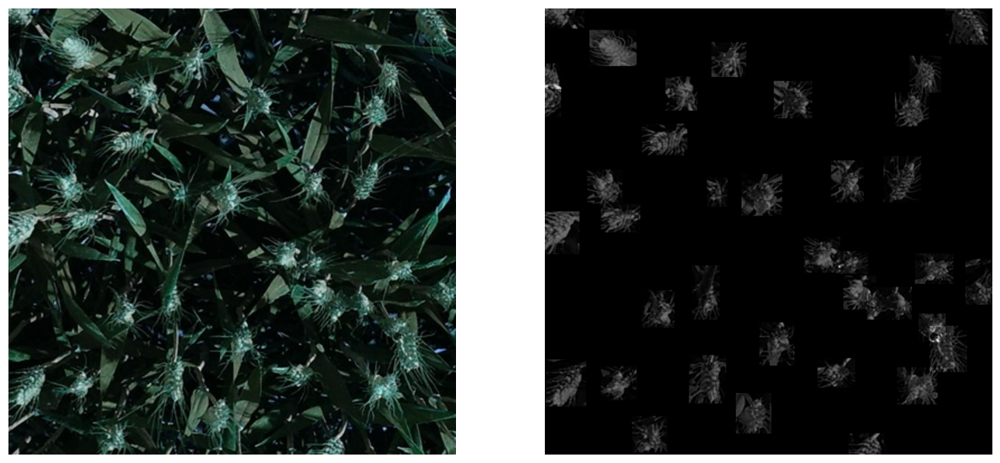

In [53]:
class_ids = [0]

while class_ids[0] == 0:  ## look for a mask
    image_id = random.choice(train_dataset.image_ids)
    image_fp = train_dataset.image_reference(image_id)
    image = train_dataset.load_image(image_id)
    mask, class_ids = train_dataset.load_mask(image_id)

print(image.shape)

plt.figure(figsize=(15, 15))
plt.subplot(1, 2, 1)
plt.imshow(image)
plt.axis('off')

plt.subplot(1, 2, 2)
masked = np.zeros(image.shape[:2])
for i in range(mask.shape[2]):
    masked += image[:, :, 0] * mask[:, :, i]
plt.imshow(masked, cmap='gray')
plt.axis('off')

# print(class_ids)
plt.show()

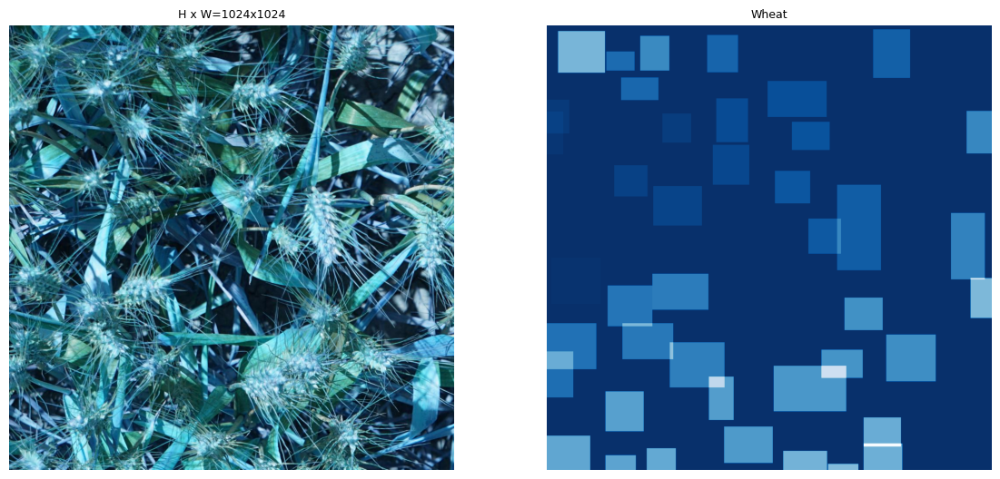

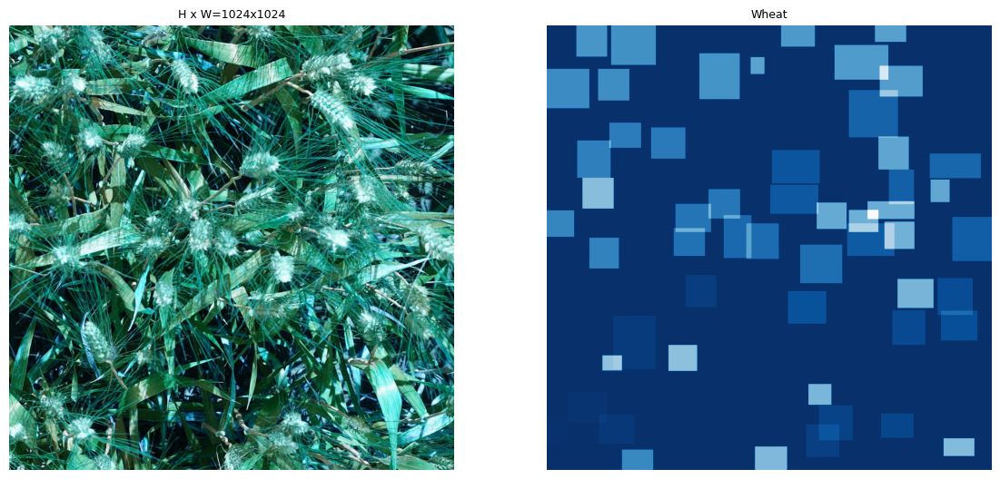

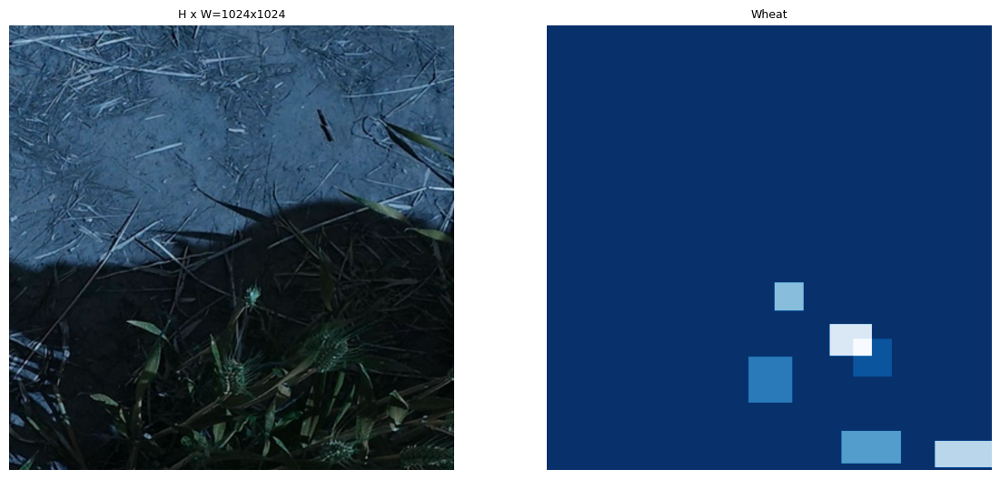

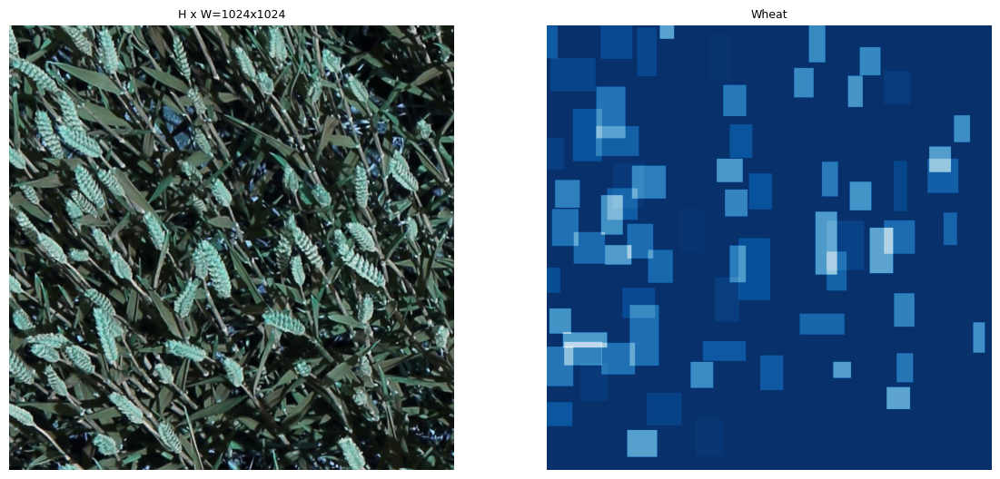

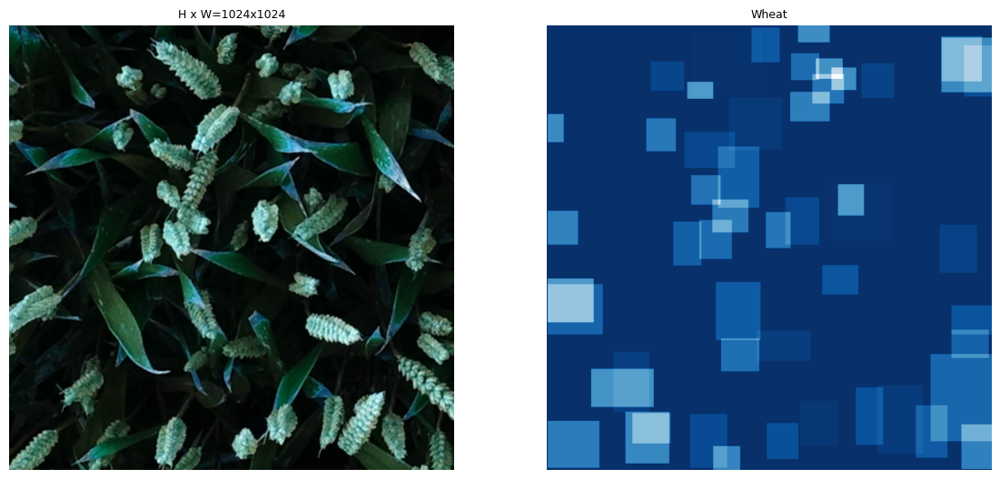

In [54]:
# Load and display random samples
image_ids = np.random.choice(train_dataset.image_ids,5)
for image_id in image_ids:
    image = train_dataset.load_image(image_id)
    mask, class_ids = train_dataset.load_mask(image_id)
    visualize.display_top_masks(image, mask, class_ids, 
                                train_dataset.class_names, limit=1)

# Data Augmentation

In [55]:
gc.collect()

20705

In [56]:
# setup an example augmentation pipeline
# be sure to use bbox safe functions for data augmentation
example_transforms = Compose([
    RandomSizedBBoxSafeCrop(512, 512, erosion_rate=0.0, interpolation=1, p=1.0),
    HorizontalFlip(p=0.5),
    VerticalFlip(p=0.5),
    OneOf([RandomBrightnessContrast(),
           RandomGamma()], p=1.0),
    CLAHE(p=1.0)], p=1.0, bbox_params=BboxParams(format='coco', label_fields=['source']))

In [71]:
# df_full['image_id'].unique()
df_full.loc[df_full['image_id'] == 'a7436f5c7'].index[0]

13

Applying Transforms:   0%|          | 0/3373 [00:00<?, ?it/s]

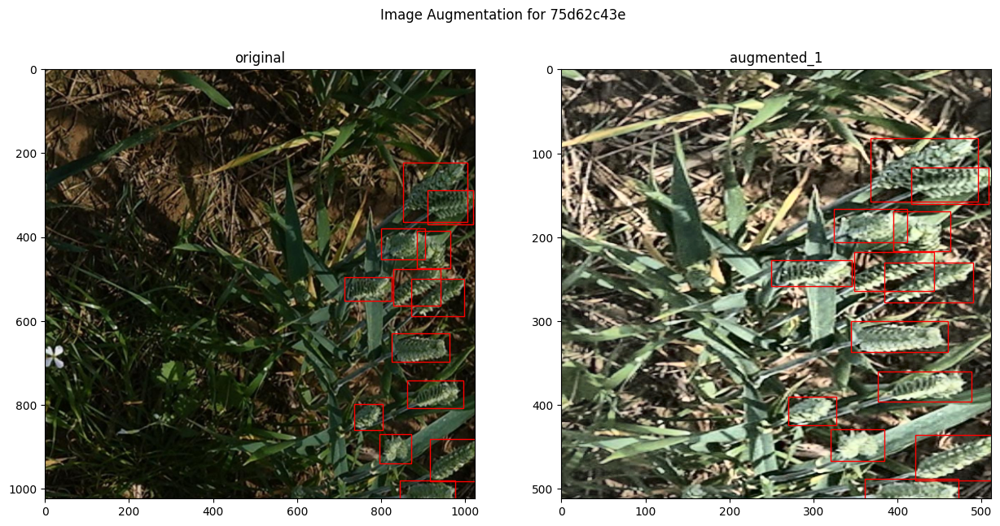

Applying Transforms:   0%|          | 1/3373 [00:00<35:50,  1.57it/s]

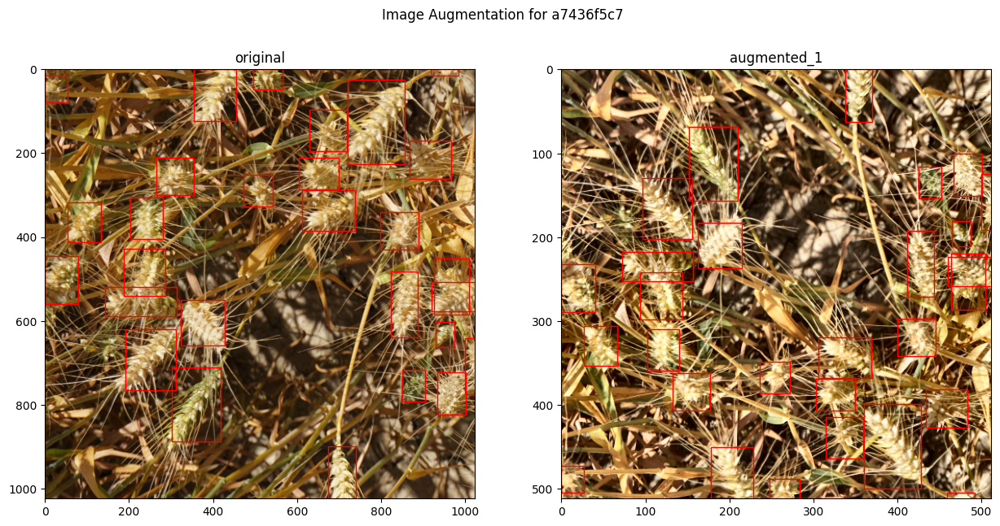

Applying Transforms:  15%|█▍        | 504/3373 [00:22<02:09, 22.07it/s]


KeyboardInterrupt: 

In [73]:
def apply_transforms(transforms, df, n_transforms=3, idx=None, TRAIN_DIR=TRAIN_DIR, SAVE_DIR=AUG_SAVE_DIR, show=True):
    if idx is None:
        idx = np.random.randint(len(df), size=1)[0]
    image_id = df.iloc[idx].image_id
    image_source_ori = df.iloc[idx].source
    bboxes = []
    for _, row in df[df.image_id == image_id].iterrows():
        bboxes.append([row.x, row.y, row.w, row.h])
        
    image = Image.open(TRAIN_DIR + image_id + '.jpg')
    
    if show:
        fig, axs = plt.subplots(1, n_transforms+1, figsize=(15,7))
        # plot the original image
        axs[0].imshow(image)
        axs[0].set_title('original')
        for bbox in bboxes:
            rect = patches.Rectangle((bbox[0],bbox[1]),bbox[2],bbox[3],linewidth=1,edgecolor='r',facecolor='none')
            axs[0].add_patch(rect)
        fig.suptitle('Image Augmentation for ' + image_id)
    
    augmented_data = []
    # apply transforms n_transforms times
    for i in range(n_transforms):
        params = {'image': np.asarray(image),
                  'bboxes': bboxes,
                  'source': ['augment_wheat' for j in range(len(bboxes))]}
        augmented_boxes = transforms(**params)
        bboxes_aug = augmented_boxes['bboxes']
        image_aug = augmented_boxes['image']
        image_source = augmented_boxes['source']

        if show:
            # plot the augmented image and augmented bounding boxes
            axs[i+1].imshow(image_aug)
            axs[i+1].set_title('augmented_' + str(i+1))
        for bbox in bboxes_aug:
            rect = patches.Rectangle((bbox[0],bbox[1]),bbox[2],bbox[3],linewidth=1,edgecolor='r',facecolor='none')
            if show:
                axs[i+1].add_patch(rect)
            augmented_data.append([image_id + '_augmented_' + str(i+1), bbox[0], bbox[1], bbox[2], bbox[3], image_source_ori])
        
        # save the augmented image
        image_aug = Image.fromarray(image_aug)
        image_aug.save(SAVE_DIR + image_id + '_augmented_' + str(i+1) + '.jpg')
        
    if show:
        plt.show()
        
    return augmented_data

def augment_df(df, n_transforms=3, TRAIN_DIR=TRAIN_DIR, SAVE_DIR=AUG_SAVE_DIR, num_show=2):
    df_zero = df[df['source'] == 'no_wheat']
    df_new = df.drop(df_zero.index)
    augmented_df = df.copy()
    augmented_data_arr = []
    counter = num_show
    all_img_id = df_new['image_id'].unique()
    
    for i in tqdm(range(all_img_id.shape[0]), desc="Applying Transforms"):
        current_image_id = all_img_id[i]
        index = df_new.loc[df_new['image_id'] == current_image_id].index[0]
        if i < num_show:
            augmented_data = apply_transforms(transforms=example_transforms, df=df_new, n_transforms=n_transforms, idx=index, TRAIN_DIR=TRAIN_DIR, SAVE_DIR=SAVE_DIR, show=True)
        else:
            augmented_data = apply_transforms(transforms=example_transforms, df=df_new, n_transforms=n_transforms, idx=index, TRAIN_DIR=TRAIN_DIR, SAVE_DIR=SAVE_DIR, show=False)
        for data in augmented_data:
            augmented_data_arr.append(data)
        
    df2 = pd.DataFrame(augmented_data_arr, columns=['image_id', 'x', 'y', 'w', 'h', 'source'])
    augmented_df = pd.concat([augmented_df, df2], ignore_index=True)
    augmented_df = pd.concat([augmented_df, df_zero], ignore_index=True)
    
    # print(len(df_zero['image_id'].unique()))
    # print(len(augmented_df['image_id'].unique()))
    return augmented_df

### Example Augmentation

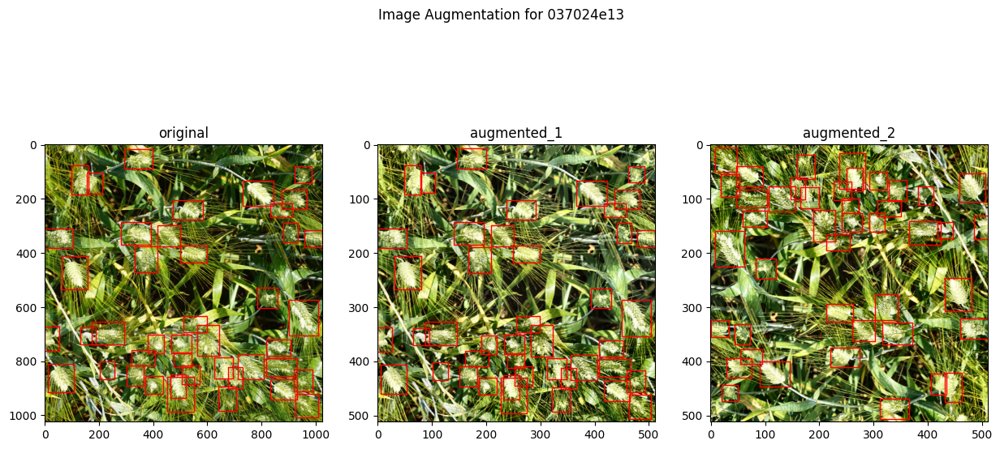

In [58]:
# Apply transforms and append augmented data to the dataframe
augmented_data = apply_transforms(example_transforms, df_full, n_transforms=2)

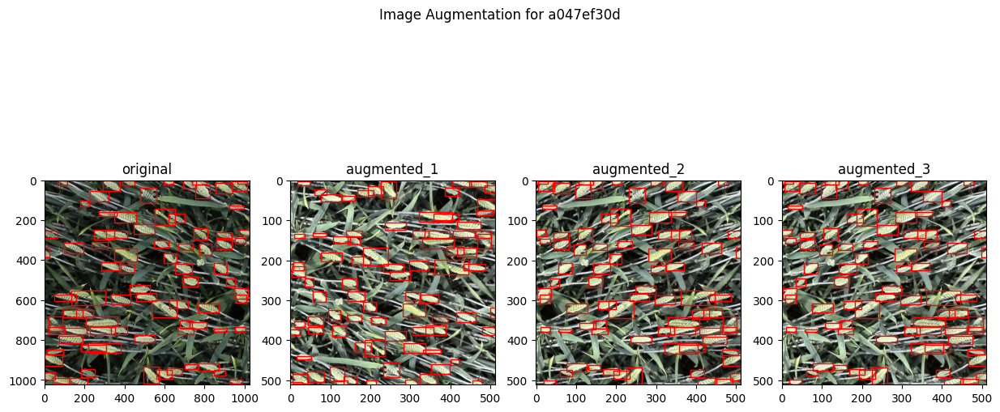

[['a047ef30d_augmented_1',
  225.5,
  2.001955034213097,
  39.0,
  42.04105571847509,
  'ethz_1'],
 ['a047ef30d_augmented_1',
  231.5,
  455.44477028347995,
  41.0,
  37.03616813294235,
  'ethz_1'],
 ['a047ef30d_augmented_1',
  414.5,
  329.822091886608,
  48.0,
  25.02443792766377,
  'ethz_1'],
 ['a047ef30d_augmented_1',
  98.0,
  466.455522971652,
  38.0,
  35.53470185728253,
  'ethz_1'],
 ['a047ef30d_augmented_1',
  499.5,
  318.3108504398827,
  12.5,
  26.025415444770317,
  'ethz_1'],
 ['a047ef30d_augmented_1',
  182.0,
  167.66373411534704,
  61.5,
  44.54349951124141,
  'ethz_1'],
 ['a047ef30d_augmented_1',
  352.5,
  459.44868035190615,
  46.5,
  26.025415444770317,
  'ethz_1'],
 ['a047ef30d_augmented_1',
  466.5,
  47.54643206256111,
  45.5,
  27.526881720430083,
  'ethz_1'],
 ['a047ef30d_augmented_1',
  323.0,
  484.9736070381232,
  42.5,
  26.525904203323535,
  'ethz_1'],
 ['a047ef30d_augmented_1',
  75.5,
  180.67644183773217,
  53.0,
  22.52199413489734,
  'ethz_1'],
 ['a04

In [59]:
apply_transforms(example_transforms, df_full, n_transforms=3)

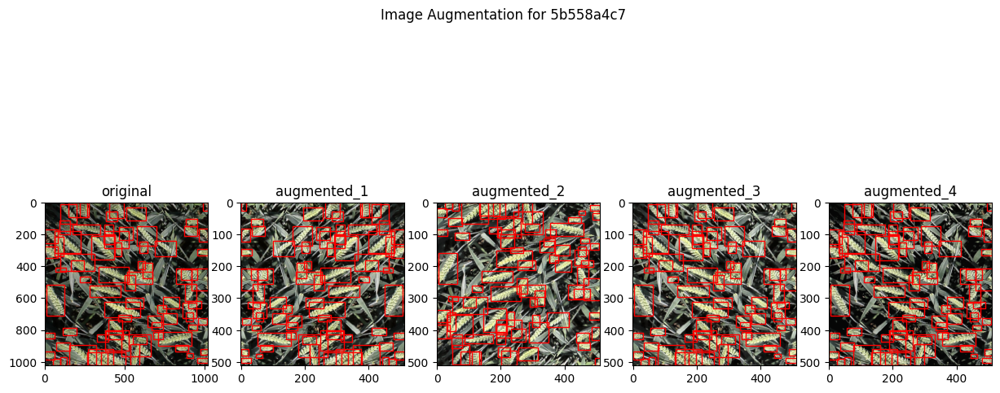

[['5b558a4c7_augmented_1', 269.0, 368.5, 44.0, 45.0, 'ethz_1'],
 ['5b558a4c7_augmented_1', 97.0, 346.5, 44.5, 33.5, 'ethz_1'],
 ['5b558a4c7_augmented_1', 91.0, 295.5, 50.5, 36.0, 'ethz_1'],
 ['5b558a4c7_augmented_1', 202.0, 299.5, 57.5, 32.0, 'ethz_1'],
 ['5b558a4c7_augmented_1', 37.0, 314.5, 42.5, 49.0, 'ethz_1'],
 ['5b558a4c7_augmented_1', 195.5, 16.0, 61.5, 41.0, 'ethz_1'],
 ['5b558a4c7_augmented_1', 34.5, 73.0, 41.5, 31.0, 'ethz_1'],
 ['5b558a4c7_augmented_1', 283.5, 27.0, 37.0, 31.0, 'ethz_1'],
 ['5b558a4c7_augmented_1', 214.5, 445.0, 29.0, 66.0, 'ethz_1'],
 ['5b558a4c7_augmented_1', 145.5, 355.5, 44.0, 36.0, 'ethz_1'],
 ['5b558a4c7_augmented_1', 453.0, 107.5, 27.0, 60.0, 'ethz_1'],
 ['5b558a4c7_augmented_1', 189.5, 122.0, 25.0, 37.5, 'ethz_1'],
 ['5b558a4c7_augmented_1', 249.5, 402.0, 74.0, 62.5, 'ethz_1'],
 ['5b558a4c7_augmented_1', 33.0, 209.5, 51.0, 32.5, 'ethz_1'],
 ['5b558a4c7_augmented_1', 388.5, 182.0, 42.0, 33.5, 'ethz_1'],
 ['5b558a4c7_augmented_1', 162.5, 73.5, 61.5, 62

In [60]:
apply_transforms(example_transforms, df_full, n_transforms=4)

### Augmentation

In [61]:
for file_name in tqdm(os.listdir(AUG_SAVE_DIR), desc="Removing Augmented Images"):
    file_path = os.path.join(AUG_SAVE_DIR, file_name)
    if os.path.isfile(file_path):
        os.remove(file_path)

Applying Transforms:   0%|          | 0/10000 [00:00<?, ?it/s]

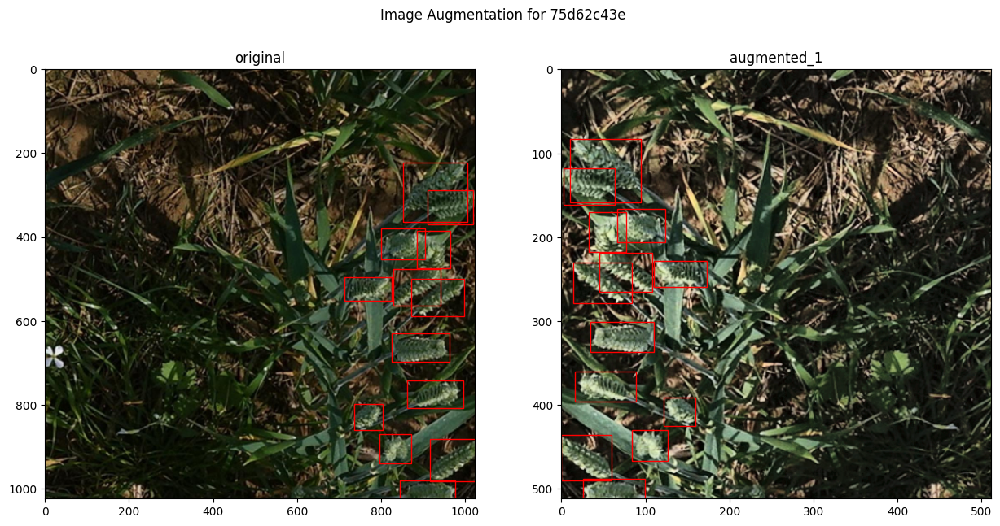

Applying Transforms:   0%|          | 11/10000 [00:01<15:59, 10.41it/s] 

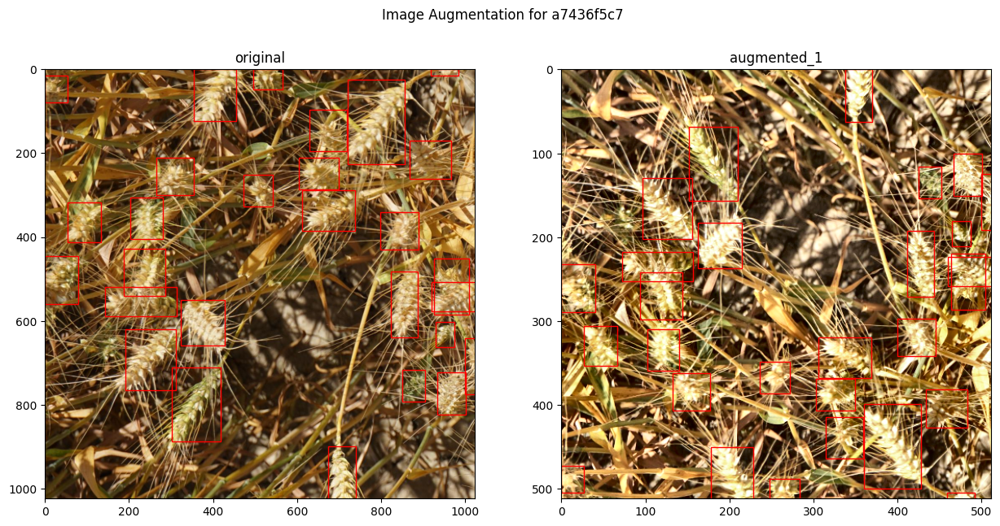

Applying Transforms:  55%|█████▌    | 5510/10000 [05:28<04:27, 16.76it/s]


KeyboardInterrupt: 

In [72]:
df_augment = augment_df(df_full, n_transforms=4)

In [63]:
df_augment.head()

,image_id,x,y,w,h,source
0,75d62c43e,863.0,741.0,132.0,67.0,arvalis_3
1,75d62c43e,844.0,980.0,133.0,44.0,arvalis_3
2,75d62c43e,736.0,798.0,68.0,63.0,arvalis_3
3,75d62c43e,825.0,630.0,137.0,68.0,arvalis_3
4,75d62c43e,853.0,223.0,152.0,142.0,arvalis_3


In [64]:
df_augment.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8023490 entries, 0 to 8023489
Data columns (total 6 columns):
 #   Column    Dtype  
---  ------    -----  
 0   image_id  object 
 1   x         float64
 2   y         float64
 3   w         float64
 4   h         float64
 5   source    object 
dtypes: float64(4), object(2)
memory usage: 367.3+ MB


In [65]:
gc.collect()

0

# Saving augmented data

In [73]:
df_augment.to_csv('df_augment.csv', index=False)

,image_id,x,y,w,h,source
0,75d62c43e,863.0,741.0,132.0,67.0,arvalis_3
1,75d62c43e,844.0,980.0,133.0,44.0,arvalis_3
2,75d62c43e,736.0,798.0,68.0,63.0,arvalis_3
3,75d62c43e,825.0,630.0,137.0,68.0,arvalis_3
4,75d62c43e,853.0,223.0,152.0,142.0,arvalis_3


In [ ]:
df_augment = pd.read_csv('df_augment.csv')
df_augment.head()

In [75]:
df_augment['image_id'].unique()

6795

In [68]:
df['source'].unique()

array(['usask_1', 'arvalis_1', 'inrae_1', 'ethz_1', 'arvalis_3', 'rres_1',
       'arvalis_2'], dtype=object)

In [69]:
df_full['source'].unique()

array(['arvalis_3', 'arvalis_1', 'arvalis_2', 'rres_1', 'inrae_1',
       'ethz_1', 'no_wheat', 'usask_1'], dtype=object)